# Исследование объявлений о продаже квартир

## Описание проекта

**Заказчик**: сервис Яндекс.Недвижимость. 

**Данные**: архив объявлений о продаже квартир в Санкт-Петербурге и соседних населённых пунктах за несколько лет.  
Часть данных получена путем пользовательского ввода.   
Иные — получены автоматически на основе картографических данных (например: расстояние до центра, аэропорта, ближайшего парка и водоёма).  

**Бизнес-цель**: определять рыночную стоимость объектов недвижимости. 

**Задача**: выявить важные параметры (например: расстояние до центра, аэропорта, ближайшего парка и водоёма) влияющие на цену недвижимости для дальнейшего построения автоматизированной системы для  отслеживания аномалий и мошеннической деятельности.

## Импорт библиотек, считывание и первичный анализ данных

In [1]:
# Установим на сервер библиотеки, которые будут использоваться в проекте, но отсутствуют
!pip install missingno -q
!pip install cufflinks -q
# Библиотека pandas-profiling не всегда устанавливается стабильно, поэтому принудительно зададим стабильные версии
!pip install pandas_profiling==1.4.1 -q
!pip install pandas==0.25.3 -q

Все три устанавливаемые библиотеки (pandas_profiling, missingno, cufflinks) помогут в проведении более тщательного EDA анализа. Исследовательский анализ можно делать и с помощью ручного вызова функций дефолтных библиотек. Предлагаемые библиотеки выбраны для максимизации комфорта презентации результатов анализа бизнес-пользователям.

In [2]:
# Импортируем требуемые для работы библиотеки

# Для работы с данными
import pandas as pd
import numpy as np
import re
from sklearn.impute import MissingIndicator
from pymystem3 import Mystem

# Для визуализации
import pandas_profiling
import missingno as msno 
import seaborn as sns
import cufflinks as cf
import matplotlib.pyplot as plt 
%matplotlib inline
cf.go_offline()

# Установка настроек для отображения всех колонок и строк при печати
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)
pd.set_option('display.float_format', lambda x: '%.5f' % x)

# Настройки для печати нескольких выводов данных в одной ячейке
from IPython.core.interactiveshell import InteractiveShell
InteractiveShell.ast_node_interactivity = "all"

# Игнорирование предупреждений об ошибках
import warnings
warnings.filterwarnings('ignore')

In [3]:
# Считываем данные
try: 
    estate_data = pd.read_csv('datasets\\real_estate_data.csv', sep='\t')
except:
    print(print('Файл {} не найден и будет скачиваться по сети.'.format('real_estate_data.csv')))
    estate_data = pd.read_csv('https://code.s3.yandex.net/datasets/real_estate_data.csv', sep='\t')    

In [4]:
# Посмотрим на 5 случайных записей набора данных
estate_data.sample(5)

,total_images,last_price,total_area,first_day_exposition,rooms,ceiling_height,floors_total,living_area,floor,is_apartment,studio,open_plan,kitchen_area,balcony,locality_name,airports_nearest,cityCenters_nearest,parks_around3000,parks_nearest,ponds_around3000,ponds_nearest,days_exposition
18399,14,10700000.00000,128.00000,2016-05-16T00:00:00,4,nan,2.00000,85.00000,1,False,False,False,12.00000,0.00000,посёлок Шушары,26293.00000,32079.00000,0.00000,nan,0.00000,nan,90.00000
15604,20,11900000.00000,107.00000,2019-02-12T00:00:00,4,nan,10.00000,65.50000,9,NaN,False,False,14.00000,nan,Санкт-Петербург,32605.00000,13704.00000,0.00000,nan,1.00000,580.00000,nan
1580,14,15990000.00000,108.70000,2016-06-14T00:00:00,3,2.76000,25.00000,61.00000,11,NaN,False,False,nan,nan,Санкт-Петербург,10663.00000,12738.00000,0.00000,nan,0.00000,nan,900.00000
22783,4,7769900.00000,78.20000,2017-05-19T00:00:00,3,nan,25.00000,48.00000,24,NaN,False,False,11.00000,nan,Санкт-Петербург,11405.00000,13222.00000,0.00000,nan,1.00000,623.00000,521.00000
2968,13,9500000.00000,60.80000,2019-03-18T00:00:00,2,nan,12.00000,35.20000,5,NaN,False,False,11.10000,nan,Санкт-Петербург,18748.00000,4341.00000,0.00000,nan,0.00000,nan,11.00000


In [5]:
# Проверим типы данных
estate_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 23699 entries, 0 to 23698
Data columns (total 22 columns):
total_images            23699 non-null int64
last_price              23699 non-null float64
total_area              23699 non-null float64
first_day_exposition    23699 non-null object
rooms                   23699 non-null int64
ceiling_height          14504 non-null float64
floors_total            23613 non-null float64
living_area             21796 non-null float64
floor                   23699 non-null int64
is_apartment            2775 non-null object
studio                  23699 non-null bool
open_plan               23699 non-null bool
kitchen_area            21421 non-null float64
balcony                 12180 non-null float64
locality_name           23650 non-null object
airports_nearest        18157 non-null float64
cityCenters_nearest     18180 non-null float64
parks_around3000        18181 non-null float64
parks_nearest           8079 non-null float64
ponds_around300

Потребуется преобразовать тип данных для признаков:

float => int
- `last_price`, `airports_nearest`, `last_price`, `cityCenters_nearest`, `parks_nearest`, `ponds_nearest` - избыточная точность 
- `floors_total`, `balcony`, `parks_around3000`, `ponds_around3000`, `days_exposition` - является целочисленным показателем

object => datetime

- `first_day_exposition` 

In [6]:
# Соберем таблицу пропущенных значений
missing_estate_data = pd.DataFrame(data={'count': estate_data.notnull().sum(),
                                'missing': estate_data.isnull().sum(),
                                'missing_persent': estate_data.isnull().sum()/estate_data.shape[0]})

missing_estate_data.query('missing!=0')\
          .sort_values(by='missing_persent', ascending=False)\
          .style.format({'missing_persent': "{:.1%}"})

,count,missing,missing_persent
is_apartment,2775,20924,88.3%
parks_nearest,8079,15620,65.9%
ponds_nearest,9110,14589,61.6%
balcony,12180,11519,48.6%
ceiling_height,14504,9195,38.8%
airports_nearest,18157,5542,23.4%
cityCenters_nearest,18180,5519,23.3%
parks_around3000,18181,5518,23.3%
ponds_around3000,18181,5518,23.3%
days_exposition,20518,3181,13.4%


В наборе данных имеется много критичных пропусков в данных. Пропуски имеются как в данных введенных пользователями, так и среди значений рассчитанных автоматически. 

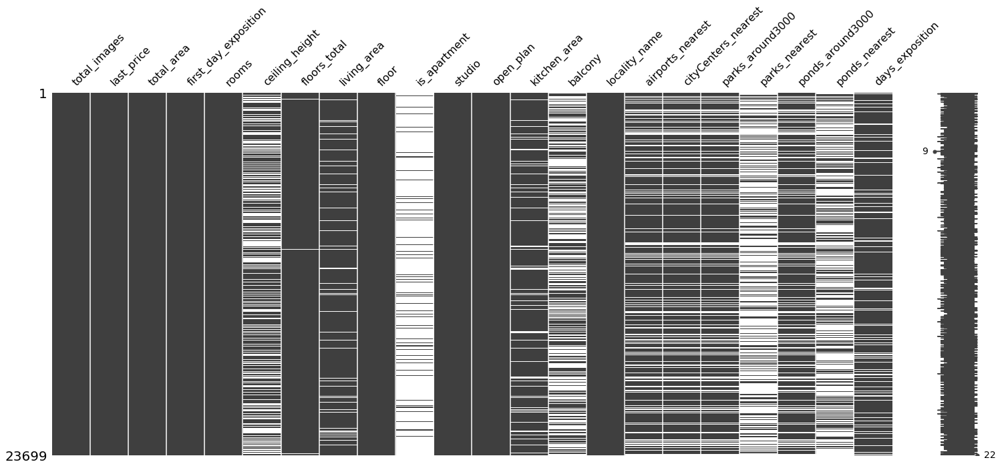

In [7]:
# Визуализируем количество пропусков в данных
msno.matrix(estate_data)

Данный инструмент позволяет на визуальном уровне подсветить интересную особенность рассматриваемого набора данных - пропуски в таких признаках как близость центра города, аэропорта, парков и прудов расположены идентично - т.е. предположительно в этих признаках данные отсутствуют для одних и тех же наблюдений. Для того чтобы понять природу данного явления, следует проанализировать данные наблюдения более тщательно. Выберем пять случайных наблюдений.

In [8]:
# Визуализируем случайные 5 значений
estate_data[estate_data['airports_nearest'].isna()].sample(5)

,total_images,last_price,total_area,first_day_exposition,rooms,ceiling_height,floors_total,living_area,floor,is_apartment,studio,open_plan,kitchen_area,balcony,locality_name,airports_nearest,cityCenters_nearest,parks_around3000,parks_nearest,ponds_around3000,ponds_nearest,days_exposition
12505,9,1900000.00000,53.00000,2016-05-31T00:00:00,3,nan,5.00000,37.00000,2,NaN,False,False,6.00000,0.00000,Приозерск,nan,nan,nan,nan,nan,nan,325.00000
10310,18,2228000.00000,32.00000,2017-11-20T00:00:00,1,nan,17.00000,14.00000,12,NaN,False,False,9.00000,nan,посёлок Мурино,nan,nan,nan,nan,nan,nan,64.00000
9172,9,3150000.00000,58.70000,2018-01-18T00:00:00,2,nan,9.00000,nan,9,NaN,False,False,nan,nan,Кировск,nan,nan,nan,nan,nan,nan,45.00000
15845,0,1500000.00000,41.00000,2017-08-14T00:00:00,1,nan,5.00000,17.00000,5,NaN,False,False,8.50000,2.00000,посёлок Торфяное,nan,nan,nan,nan,nan,nan,214.00000
20555,12,2200000.00000,44.70000,2018-07-05T00:00:00,2,2.50000,5.00000,30.20000,1,NaN,False,False,7.30000,nan,посёлок Пудость,nan,nan,nan,nan,nan,nan,194.00000


В значениях признака `locality_name` мы видим, что это ислючительно населенные пункты, которые располагаются в области. По всей видимости, у данных типов населенных пунктов нет водоемов и парков в ближайшем радиусе. От центра Санкт-Петербурга и аэропорта, они также распологаются довольно далеко.  

Но, в признаках `ponds_nearest` и `parks_neares` пропусков в три раза больше (примерно по 60%). Посмотрим на наблюдения, в которых значения этих признаков отсутствуют, но имеются значения в признаках `airports_nearest` и `cityCenters_nearest` 

In [9]:
# Визуализируем случайные 5 значений
estate_data[(estate_data['ponds_nearest'].isna())&(estate_data['airports_nearest'].notnull())].sample(5)

,total_images,last_price,total_area,first_day_exposition,rooms,ceiling_height,floors_total,living_area,floor,is_apartment,studio,open_plan,kitchen_area,balcony,locality_name,airports_nearest,cityCenters_nearest,parks_around3000,parks_nearest,ponds_around3000,ponds_nearest,days_exposition
4286,8,3200000.00000,31.70000,2016-08-17T00:00:00,1,nan,12.00000,16.18000,10,NaN,False,False,7.00000,0.00000,Санкт-Петербург,33183.00000,12258.00000,1.00000,684.00000,0.00000,nan,219.00000
11728,20,4950000.00000,75.00000,2015-04-07T00:00:00,3,nan,9.00000,45.00000,1,NaN,False,False,10.00000,nan,Санкт-Петербург,27852.00000,11559.00000,2.00000,223.00000,0.00000,nan,1037.00000
12629,7,14500000.00000,106.00000,2017-05-30T00:00:00,3,2.76000,12.00000,54.00000,8,NaN,False,False,23.00000,nan,Санкт-Петербург,44151.00000,13731.00000,1.00000,633.00000,0.00000,nan,567.00000
23456,5,3950000.00000,39.50000,2017-11-11T00:00:00,1,2.75000,26.00000,16.70000,21,NaN,False,False,10.40000,nan,посёлок Парголово,52768.00000,17994.00000,0.00000,nan,0.00000,nan,298.00000
12588,11,6150000.00000,51.36000,2019-04-04T00:00:00,2,2.60000,9.00000,28.30000,6,NaN,False,False,7.10000,nan,Санкт-Петербург,14128.00000,17073.00000,0.00000,nan,0.00000,nan,nan


Анализ наблюдений показал, что это преимущественно районы Санкт-Перербурга, в которых может не быть парков/прудов в ближайшем радиусе - например, промышленные/"спальные" районы или районы с плотной застройкой.

Проанализируем описательные статистики и распределения значения признаков. 

In [10]:
# Используем метод describe для всех типов данных присутствующих в наборе данных
estate_data.describe()
estate_data.describe(include=['object', 'bool'])

,total_images,last_price,total_area,rooms,ceiling_height,floors_total,living_area,floor,kitchen_area,balcony,airports_nearest,cityCenters_nearest,parks_around3000,parks_nearest,ponds_around3000,ponds_nearest,days_exposition
count,23699.00000,23699.00000,23699.00000,23699.00000,14504.00000,23613.00000,21796.00000,23699.00000,21421.00000,12180.00000,18157.00000,18180.00000,18181.00000,8079.00000,18181.00000,9110.00000,20518.00000
mean,9.85848,6541548.77155,60.34865,2.07064,2.77150,10.67382,34.45785,5.89236,10.56981,1.15008,28793.67219,14191.27783,0.61141,490.80456,0.77025,517.98090,180.88863
std,5.68253,10887013.26754,35.65408,1.07840,1.26106,6.59717,22.03045,4.88525,5.90544,1.07130,12630.88062,8608.38621,0.80207,342.31799,0.93835,277.72064,219.72799
min,0.00000,12190.00000,12.00000,0.00000,1.00000,1.00000,2.00000,1.00000,1.30000,0.00000,0.00000,181.00000,0.00000,1.00000,0.00000,13.00000,1.00000
25%,6.00000,3400000.00000,40.00000,1.00000,2.52000,5.00000,18.60000,2.00000,7.00000,0.00000,18585.00000,9238.00000,0.00000,288.00000,0.00000,294.00000,45.00000
50%,9.00000,4650000.00000,52.00000,2.00000,2.65000,9.00000,30.00000,4.00000,9.10000,1.00000,26726.00000,13098.50000,0.00000,455.00000,1.00000,502.00000,95.00000
75%,14.00000,6800000.00000,69.90000,3.00000,2.80000,16.00000,42.30000,8.00000,12.00000,2.00000,37273.00000,16293.00000,1.00000,612.00000,1.00000,729.00000,232.00000
max,50.00000,763000000.00000,900.00000,19.00000,100.00000,60.00000,409.70000,33.00000,112.00000,5.00000,84869.00000,65968.00000,3.00000,3190.00000,3.00000,1344.00000,1580.00000


,first_day_exposition,is_apartment,studio,open_plan,locality_name
count,23699,2775,23699,23699,23650
unique,1491,2,2,2,364
top,2018-02-01T00:00:00,False,False,False,Санкт-Петербург
freq,368,2725,23550,23632,15721


С помощью инструмента pandas_profiling можно быстро ознакомиться с основными характеристиками изучаемого набора данных: увидеть информацию о типах данных, пропусках, дубликатах, распределениях, корреляции признаков.

In [11]:
# Запускаем библиотеку pandas_profiling для проведения исследовательского анализа данных
pandas_profiling.ProfileReport(estate_data)

Number of variables,22
Number of observations,23699
Total Missing (%),19.1%
Total size in memory,3.7 MiB
Average record size in memory,162.0 B
Numeric,16
Categorical,2
Boolean,2
Date,0
Text (Unique),0
Rejected,1


Данные имеют много особенностей, которые потребуется проанализировать более детально и, при необходимости, обработать:
- в признаках `last_price` и `total_area` представлены несколько категорий жилья. Как комнаты за небольшую плату, так и дорогое жилье за крупные суммы. 
- потребуется более детально проанализировать признак `ceiling_height`, т.к. встречаются значения 1м. и 100м., что, скорее всего, является ошибкой ввода
- в данных имеется два наблюдения с `living_area` равным 2м. Это тоже может быть ошибкой данных, особенно при условии других значений признаков (стоимости, площади кухни, типа жилья)
- в признаках `total_images`, `balcony`, `rooms` имеются нулевые значения, но это не является ошибкой данных
- гистограммы многих распределений имеют "тяжелый правый хвост"
- на матрицах корреляции выявлена значимая корреклция между признаками:  
`living_area` и `kitchen_area` 0.7   
`airports_nearest` и `cityCenters_nearest` 1.0  
`parks_around3000` и `airports_nearest`/`cityCenters_nearest` 1.0  
`ponds_around3000` и `parks_around3000`/`airports_nearest`/`cityCenters_nearest` 1.0

Проверим данные на противоречивость

In [12]:
# Проверим наличие наблюдений, в которых обозначенный этаж расположения квартиры больше, чем количество этажей в доме
floor_res = estate_data.query('floors_total<floor')['floor'].count()
print('Количество наблюдений, в которых обозначенный этаж расположения квартиры больше, чем количество этажей в доме:', floor_res)

Количество наблюдений, в которых обозначенный этаж расположения квартиры больше, чем количество этажей в доме: 0


In [13]:
# Проверим наличие наблюдений, в которых жилая площадь квартиры больше, чем общая площадь
area_res = estate_data.query('total_area<living_area')
print('Количество наблюдений, в которых жилая площадь квартиры больше, чем общая площадь:', floor_res)

Количество наблюдений, в которых жилая площадь квартиры больше, чем общая площадь: 0


In [14]:
# Проверим наличие наблюдений, в которых площадь кухни больше, чем общая или  жилая площадь
kitchen_res_1 = estate_data.query('kitchen_area>total_area')['kitchen_area'].count()
kitchen_res_2 = estate_data.query('kitchen_area>living_area')['kitchen_area'].count()
print('Количество наблюдений, в которых площадь кухни больше, чем общая площадь квартиры:', kitchen_res_1)
print('Количество наблюдений, в которых площадь кухни больше, чем жилая площадь квартиры:', kitchen_res_2)

Количество наблюдений, в которых площадь кухни больше, чем общая площадь квартиры: 0
Количество наблюдений, в которых площадь кухни больше, чем жилая площадь квартиры: 355


### Вывод


**Замена типа данных**

Потребуется преобразовать тип данных для признаков:  
float => int  
`last_price`, `airports_nearest`, `last_price`, `cityCenters_nearest`, `parks_nearest`, `ponds_nearest`, 
`floors_total`, `balcony`, `parks_around3000`, `ponds_around3000`, `days_exposition`  

object => datetime  

`first_day_exposition`   

**Лемматизация**
- `locality_name` (привести к основе и единообразию отображения названий населенных пунктом, т.к. в данных могут присутствовать по несколько вариаций одного наименования. Например, Мурино)

**Категоризация**  
Т.к. в данных имеется так называемая "проблема Билла Гейтса" - слишком отличающиеся значения по цене/площади квартир. Такие данные не являются ошибочными, т.к. действительно бывают как слишком большие/дорогие квартиры, так и совсем малогабаритные. 
Для обработки таких ситуаций предлагается создать отдельную колонку с категорией жилья, с вариантами эконом/комфорт/бизнес/элитное. В последюущем, при построении моделей машинного обучения, рекомендуется для типов жилья критично отличающихся друг от друга, например эконом/комфорт и бизнес/элитное строить раздельные модели. Такой подход распространен в банковском секторе. 

**Новая колонка**
- Спб и ближайшая область / малые населенные пункты
- цена квадратного метра
- день недели публикации объявления 
- месяц публикации объявления
- год публикации объявления 
- категория этажа квартиры (первый, последний, другой)
- соотношение жилой и общей площади
- отношение площади кухни к общей


**Некорректные данные**
- `ceiling_height` минимальная значение 1м, максимальное 100   
- `living_area` минимальное значение 2м 
- 355 наблюдений, в которых площадь кухни больше, чем жилая площадь квартиры 
Предлагается удалить значения, как ошибочные и  невозможные к восстановлению. Высоту потолков проанализировать дополнительно.

**Пропуски в данных** 
- `floors_total` (0.4%) и `locality_name` (0.2%) - удалить наблюдения, т.к. нет возможности восстановить эти значения по другим признакам
- `kitchen_area` (9.6%), `living_area` (8.0%) `ceiling_height` (38.8%), `days_exposition` (12.3%) заполнить медианным значением в зависимости от принадлежности к категории  жилья по коэффициентам и площади
- `airports_nearest`(23.4%) , `cityCenters_nearest` (23.3%) - заполнить значением out-of-range
- `parks_nearest` (65.9%), `ponds_nearest`(61.6%) - заполнить значением out-of-range  
- `parks_around3000` (23.3%) и `ponds_around3000` (23.3%) - заполнить значением 0
- `balcony` (48.6%) - исходя из предположения, что отсутствие значения свидетельстует об отсутствии балкона, заполнить нулями
- `is_apartment` 88.3% - сделать признак категориальным True => Да, False => Нет, missing => Нет информации

Для признаков, в которых пропуски будут заменяться медианными значениями в зависимости от категории, создать колонку-флаг, в которой на месте пропуска будет стоять значение True.

## Feature engineering

На основании имеющихся признаков создадим дополнительные, которые помогут более качественно проанализировать набор имеющихся данных. 

In [15]:
# Рассчитаем цену квадратного метра
estate_data['price_per_sqr_meter'] = round(estate_data['last_price'] / estate_data['total_area'], 0)

In [16]:
# Создадим признаки на основании даты: день недели, месяц и год публикации объявления
# Для этого сначала скорректируем тип даннх признака first_day_exposition в datetime
estate_data['first_day_exposition']=pd.to_datetime(estate_data['first_day_exposition'], format='%Y%m%dT%H:%M:%S')
estate_data['day_of_week_exposition'] = estate_data['first_day_exposition'].dt.day_name()
estate_data['year_exposition'] = estate_data['first_day_exposition'].dt.year
estate_data['month_exposition'] = estate_data['first_day_exposition'].dt.month

In [17]:
# Создадим признак отражающий характеристику этажа квартиры: первый, последний или другой
estate_data['floor_info'] = np.where(estate_data['floor'] == 1, 'первый',
                           (np.where(estate_data['floor'] == estate_data['floors_total'], 'последний', 'другой')))    

estate_data['floor_info'].value_counts()

другой       17446
последний     3336
первый        2917
Name: floor_info, dtype: int64

In [18]:
# Посчитаем и сохраним в отдельных колонках соотношение жилой и общей площади, отношение площади кухни к общей
estate_data['coef_living_total'] = round(estate_data['living_area']/estate_data['total_area'], 2)
estate_data['coef_kitchen_total'] = round(estate_data['kitchen_area']/estate_data['total_area'], 2)

In [19]:
# Создадим признак содержащий категорию жилья: эконом, комфорт, бизнес, элитное
estate_data['total_area_class']=pd.cut(estate_data['total_area'],[-np.inf, 50, 100, 200, +np.inf], labels = ['эконом', 'комфорт', 'бизнес', 'элитное'])
estate_data['total_area_class'].value_counts() 

эконом     11214
комфорт    10649
бизнес      1609
элитное      227
Name: total_area_class, dtype: int64

In [20]:
# Проверим на корректность 
estate_data.sample(3)

,total_images,last_price,total_area,first_day_exposition,rooms,ceiling_height,floors_total,living_area,floor,is_apartment,studio,open_plan,kitchen_area,balcony,locality_name,airports_nearest,cityCenters_nearest,parks_around3000,parks_nearest,ponds_around3000,ponds_nearest,days_exposition,price_per_sqr_meter,day_of_week_exposition,year_exposition,month_exposition,floor_info,coef_living_total,coef_kitchen_total,total_area_class
5352,15,7490000.00000,84.50000,2018-01-18,3,2.70000,16.00000,52.00000,9,False,False,False,14.00000,1.00000,Санкт-Петербург,25974.00000,14687.00000,1.00000,464.00000,0.00000,nan,74.00000,88639.00000,Thursday,2018,1,другой,0.62000,0.17000,комфорт
18700,4,10000000.00000,91.00000,2018-03-19,3,3.00000,4.00000,nan,2,NaN,False,False,nan,nan,Санкт-Петербург,22491.00000,3756.00000,0.00000,nan,1.00000,692.00000,90.00000,109890.00000,Monday,2018,3,другой,nan,nan,комфорт
5526,20,7300000.00000,65.00000,2017-04-07,2,nan,4.00000,36.00000,3,NaN,False,False,12.08000,0.00000,Санкт-Петербург,22863.00000,2371.00000,0.00000,nan,3.00000,841.00000,143.00000,112308.00000,Friday,2017,4,другой,0.55000,0.19000,комфорт


### Вывод

Сгенерированы новые признаки:
- стоимость квадратного метра
- признаки на основании даты: день недели, месяц и год публикации объявления
- характеристика этажа квартиры
- категория жилья: эконом, комфорт, бизнес, элитное

## Предобработка данных

### Обработка пропусков

In [21]:
# Напишем функцию для создания признака-флага 
# На вход принимает признак у которого есть пропуски
# Результат - новая колонка со значением True на месте пропуска в исходной колонке
def flag(feature, feature_name):
        
    miss_i = MissingIndicator()
    miss_i.fit(estate_data[[feature]])
    estate_data[feature_name] = miss_i.transform(estate_data[[feature]])

# Делаем вызов функции flag для признаков kitchen_area, living_area, ceiling_height
for column in ['kitchen_area', 'living_area', 'ceiling_height']:
    flag(column, column + '_flag') 

estate_data.sample(2)

,total_images,last_price,total_area,first_day_exposition,rooms,ceiling_height,floors_total,living_area,floor,is_apartment,studio,open_plan,kitchen_area,balcony,locality_name,airports_nearest,cityCenters_nearest,parks_around3000,parks_nearest,ponds_around3000,ponds_nearest,days_exposition,price_per_sqr_meter,day_of_week_exposition,year_exposition,month_exposition,floor_info,coef_living_total,coef_kitchen_total,total_area_class,kitchen_area_flag,living_area_flag,ceiling_height_flag
3969,20,8700000.00000,84.00000,2019-03-17,3,2.58000,26.00000,48.00000,2,NaN,False,False,14.30000,2.00000,посёлок Парголово,53179.00000,19356.00000,0.00000,nan,0.00000,nan,nan,103571.00000,Sunday,2019,3,другой,0.57000,0.17000,комфорт,False,False,False
15044,6,3950000.00000,31.00000,2018-08-21,1,2.50000,5.00000,18.00000,4,NaN,False,False,6.00000,nan,Санкт-Петербург,9955.00000,10894.00000,0.00000,nan,0.00000,nan,149.00000,127419.00000,Tuesday,2018,8,другой,0.58000,0.19000,эконом,False,False,False


In [22]:
# Напишем функцию для удаления строк с пропусками в конкретной колонке
def del_NaN(column, estate_data):
    # Сделаем проверку строк с пустыми знаечниями в признаке до их удаления
    print("Количество строк с пустыми значениями в признаке {} до удаления: {}.".format(column, estate_data[column].isnull().sum())) 
            
    # Удалим значения
    estate_data = estate_data[estate_data[column].notnull()]
    
    # Сделаем проверку строк с пустыми знаечниями в признаке после удаления      
    print("Количество строк с пустыми значениями в признаке {} после удаления: {}.".format(column, estate_data[column].isnull().sum()))
    print('----------------------------------')
    
    return estate_data

In [23]:
# Применим функцию del_NaN для признаков floors_total и locality_name
for column in ['floors_total', 'locality_name']:
    estate_data = del_NaN(column, estate_data)

Количество строк с пустыми значениями в признаке floors_total до удаления: 86.
Количество строк с пустыми значениями в признаке floors_total после удаления: 0.
----------------------------------
Количество строк с пустыми значениями в признаке locality_name до удаления: 48.
Количество строк с пустыми значениями в признаке locality_name после удаления: 0.
----------------------------------


Обработаем значения в признаке `is_apartment` - True => Да, False => Нет, missing => Нет информации

In [24]:
# Заменим булево значения
estate_data['is_apartment'] = estate_data['is_apartment'].replace({True: 'Да', False: 'Нет'})
# Заполним пропуски
estate_data['is_apartment'] = estate_data['is_apartment'].fillna('Нет информации')
# Убедимся в корректности обработки
estate_data['is_apartment'].value_counts()

Нет информации    20805
Нет                2710
Да                   50
Name: is_apartment, dtype: int64

Выполним обработку автоматически расчитанных признаков `parks_nearest`, `ponds_nearest`, `airports_nearest`, `cityCenters_nearest`. Для заполнения пропусков в этих признаках будет использоваться методика out-of-range. Следует аккуратно использовать этот метод, в случае последующего моделирования - что может быть хорошо для моделей на основе деревьев, но может отрицательно сказаться на качестве регрессионных моделей. Окончательное решение о конкретном значении лучше принимать либо после выбора модели, либо подбирать экспериментально наряду с подбором гиперпараметров. 

In [25]:
# Вспомним максимальные значения рассматриваемых признаков
lst_missing = ['parks_nearest', 'ponds_nearest', 'airports_nearest', 'cityCenters_nearest']
for column in lst_missing:
    print('Максимальное значение признака {}: {}'.format(column, estate_data[column].max()))

Максимальное значение признака parks_nearest: 3190.0
Максимальное значение признака ponds_nearest: 1344.0
Максимальное значение признака airports_nearest: 84869.0
Максимальное значение признака cityCenters_nearest: 65968.0


In [26]:
# Сформируем список значений out-of-range для каждого признака и используем эти значения для замены пропусков
lst_out = [3500, 3500, 85000, 70000]
for i in range(len(lst_missing)):
    estate_data[lst_missing[i]] = estate_data[lst_missing[i]].fillna(lst_out[i])

In [27]:
# Заполним пропуски в признаках balcony, parks_around3000 и ponds_around3000 нулями
estate_data['balcony'] = estate_data['balcony'].fillna(0)
estate_data['parks_around3000'] = estate_data['parks_around3000'].fillna(0)
estate_data['ponds_around3000'] = estate_data['ponds_around3000'].fillna(0)

In [28]:
# Посчитаем медианное значение в столбце days_exposition и сохраним в переменную days_exposition_median и выведем её значение
days_exposition_median = estate_data['days_exposition'].median()
days_exposition_median

95.0

In [29]:
# Заменим значение NAN в ризнаке days_exposition на медиану
estate_data['days_exposition'] = estate_data['days_exposition'].fillna(days_exposition_median)

### Лемматизация

Признак `locality_name` содержит как названия, так и определение населенного пункта, разделим их и запишем в разные колонки. Одновременно сформируем признак, в котором будет храниться информация о принадлежности к городу и его области, либо другим удаленным населенным пунктам.  
Проверим состояние признака до обработки на выявленном примере населенного пункта Мурино:

In [30]:
estate_data[estate_data['locality_name'].str.contains('Мурино', case=False)].head(3)

,total_images,last_price,total_area,first_day_exposition,rooms,ceiling_height,floors_total,living_area,floor,is_apartment,studio,open_plan,kitchen_area,balcony,locality_name,airports_nearest,cityCenters_nearest,parks_around3000,parks_nearest,ponds_around3000,ponds_nearest,days_exposition,price_per_sqr_meter,day_of_week_exposition,year_exposition,month_exposition,floor_info,coef_living_total,coef_kitchen_total,total_area_class,kitchen_area_flag,living_area_flag,ceiling_height_flag
8,20,2900000.00000,33.16000,2018-05-23,1,nan,27.00000,15.43000,26,Нет информации,False,False,8.81000,0.00000,посёлок Мурино,85000.00000,70000.00000,0.00000,3500.00000,0.00000,3500.00000,189.00000,87455.00000,Wednesday,2018,5,другой,0.47000,0.27000,эконом,False,False,True
38,10,3150000.00000,40.00000,2018-03-29,1,2.75000,18.00000,16.30000,9,Нет информации,False,False,11.60000,0.00000,посёлок Мурино,85000.00000,70000.00000,0.00000,3500.00000,0.00000,3500.00000,103.00000,78750.00000,Thursday,2018,3,другой,0.41000,0.29000,эконом,False,False,False
60,3,2740000.00000,35.00000,2018-01-01,1,nan,12.00000,nan,8,Нет информации,False,False,nan,0.00000,посёлок Мурино,85000.00000,70000.00000,0.00000,3500.00000,0.00000,3500.00000,11.00000,78286.00000,Monday,2018,1,другой,nan,nan,эконом,True,True,True


In [31]:
print('Уникальных значений в признаке locality_name до обработки: {}'.format(len(estate_data['locality_name'].unique())))

Уникальных значений в признаке locality_name до обработки: 364


In [32]:
# Напишем функцию для лемматизации и последующей категоризации значений признака locality_name
def get_area(name):
    if name in ['Санкт Петербург', 'Пушкин', 'Петергоф', 'Колпино', 
                'Кронштадт','Сестрорецк', 'Красное Село','Павловск', 
                'Стрельна', 'Ломоносов','Зеленогорск', 'Парголово']:
        return 'СПБ и ближайшая область'
    return 'малые населенные пункты'

def lemmatize(string):
    lemma = m.lemmatize(string)
    name = ' '.join(re.findall('[А-ЯЁ]\w+', string))
    area = get_area(name)
    if 'поселок' in lemma:
        return  'поселок', name, area  
    elif 'деревня' in lemma :
        return  'деревня', name, area  
    elif 'городской' in lemma:
        return  'поселок городского типа', name, area  
    elif 'село' in lemma:
        return  'село', name, area  
    elif 'коттеджный' in lemma:
        return  'коттеджный поселок', name, area  
    elif 'садовый' in lemma:
        return  'СНТ', name, area  
    elif 'санкт-петербург' in lemma:
        return  'город', name, area  
    return 'другое', name, area  

# Делаем вызов функции lemmatize
m = Mystem() 
estate_data['locality_group'], estate_data['locality_name'], estate_data['locality_area'],  = zip(*estate_data['locality_name'].apply(lemmatize))

Убедимся в корректности обработки:

In [33]:
estate_data[estate_data['locality_name'].str.contains('Мурино', case=False)].head(3)

,total_images,last_price,total_area,first_day_exposition,rooms,ceiling_height,floors_total,living_area,floor,is_apartment,studio,open_plan,kitchen_area,balcony,locality_name,airports_nearest,cityCenters_nearest,parks_around3000,parks_nearest,ponds_around3000,ponds_nearest,days_exposition,price_per_sqr_meter,day_of_week_exposition,year_exposition,month_exposition,floor_info,coef_living_total,coef_kitchen_total,total_area_class,kitchen_area_flag,living_area_flag,ceiling_height_flag,locality_group,locality_area
8,20,2900000.00000,33.16000,2018-05-23,1,nan,27.00000,15.43000,26,Нет информации,False,False,8.81000,0.00000,Мурино,85000.00000,70000.00000,0.00000,3500.00000,0.00000,3500.00000,189.00000,87455.00000,Wednesday,2018,5,другой,0.47000,0.27000,эконом,False,False,True,поселок,малые населенные пункты
38,10,3150000.00000,40.00000,2018-03-29,1,2.75000,18.00000,16.30000,9,Нет информации,False,False,11.60000,0.00000,Мурино,85000.00000,70000.00000,0.00000,3500.00000,0.00000,3500.00000,103.00000,78750.00000,Thursday,2018,3,другой,0.41000,0.29000,эконом,False,False,False,поселок,малые населенные пункты
60,3,2740000.00000,35.00000,2018-01-01,1,nan,12.00000,nan,8,Нет информации,False,False,nan,0.00000,Мурино,85000.00000,70000.00000,0.00000,3500.00000,0.00000,3500.00000,11.00000,78286.00000,Monday,2018,1,другой,nan,nan,эконом,True,True,True,поселок,малые населенные пункты


In [34]:
print('Уникальных значений в признаке locality_name после обработки: {}'.format(len(estate_data['locality_name'].unique())))

Уникальных значений в признаке locality_name после обработки: 305


In [35]:
# Напишем функцию, которая заменяет пропуски на медианное значение умноженное на коэффициент по категории, 
# в зависимости от категории строки с пропуском
def replace_NaN(column_name, total_area_type, coef=None):
    
    if coef is None:
    
        #считаем медианное значение показателя для данной категории жилья
        median = estate_data[estate_data['total_area_class'] == total_area_type][column_name].median()

        #создадим series нулевых значений колонки 
        estate_data.loc[(estate_data[column_name].isnull()) & (estate_data['total_area_class'] == total_area_type), column_name] = median 
    
    else: 
        #считаем медианное значение коэффициента для данной категории жилья
        median_coef = estate_data[estate_data['total_area_class'] == total_area_type][coef].median()

        #создадим series нулевых значений колонки 
        estate_data_isnull = estate_data.loc[(estate_data[column_name].isnull()) & (estate_data['total_area_class'] == total_area_type), column_name]

        for i in estate_data_isnull.index:
            result = estate_data.loc[i, 'total_area'] * median_coef
            estate_data.loc[i, column_name] = result       

In [36]:
# Применим функцию replace_NaN для замены пропусков в признаках kitchen_area, living_area, ceiling_height, days_exposition
dict_col = {'kitchen_area': 'coef_kitchen_total' ,
 'living_area' : 'coef_living_total', 
 'ceiling_height': None, 
 'days_exposition': None}

for column, coef in dict_col.items():
    print("Показатель mean по признаку {} до замены пропусков: {:.2f}".format(column, estate_data[column].mean()))
    print("Показатель median по признаку {} до замены пропусков: {:.2f}".format(column, estate_data[column].median()))
    group_for_replace_nan = estate_data[estate_data[column].isnull()]['total_area_class'].unique()
    for group in group_for_replace_nan:
        replace_NaN(column, group, coef)
    print("Показатель mean по признаку {} после замены пропусков: {:.2f}".format(column, estate_data[column].mean()))    
    print("Показатель median по признаку {} после замены пропусков: {:.2f}".format(column, estate_data[column].median()))
    print('--------------------------------------------------------------')

Показатель mean по признаку kitchen_area до замены пропусков: 10.56
Показатель median по признаку kitchen_area до замены пропусков: 9.10
Показатель mean по признаку kitchen_area после замены пропусков: 10.46
Показатель median по признаку kitchen_area после замены пропусков: 9.05
--------------------------------------------------------------
Показатель mean по признаку living_area до замены пропусков: 34.45
Показатель median по признаку living_area до замены пропусков: 30.00
Показатель mean по признаку living_area после замены пропусков: 34.61
Показатель median по признаку living_area после замены пропусков: 30.00
--------------------------------------------------------------
Показатель mean по признаку ceiling_height до замены пропусков: 2.77
Показатель median по признаку ceiling_height до замены пропусков: 2.65
Показатель mean по признаку ceiling_height после замены пропусков: 2.73
Показатель median по признаку ceiling_height после замены пропусков: 2.65
------------------------------

Как видно, после заполнения пропусков не выявлено критичных изменений статистик. 

In [37]:
# Обновим коэффициенты, для заполнения наблюдений, которые ранее имели пропуски
estate_data['coef_living_total'] = round(estate_data['living_area']/estate_data['total_area'], 2)
estate_data['coef_kitchen_total'] = round(estate_data['kitchen_area']/estate_data['total_area'], 2)

In [38]:
# Соберем таблицу пропущенных значений
missing_estate_data = pd.DataFrame(data={'count': estate_data.notnull().sum(), 'missing': estate_data.isnull().sum(), 'missing_persent':estate_data.isnull().sum()/estate_data.shape[0]})
missing_estate_data.query('missing!=0').sort_values(by='missing_persent', ascending=False).style.format({'missing_persent': "{:.1%}"})

,count,missing,missing_persent


Все пропуски заполнены.

### Преобразование типов данных

In [39]:
# Преобразование типа данных float64 -> int64:
for column in ['total_images', 'last_price', 'rooms', 'floors_total',
               'floor', 'balcony', 'airports_nearest', 'cityCenters_nearest', 'parks_around3000',
               'parks_nearest', 'ponds_around3000', 'ponds_nearest', 'days_exposition']:
    estate_data[column] = estate_data[column].astype('int64')    

### Вывод

- обработаны пропуски 
- произведена обработка признака locality_name
- преобразованы типы данных

## Исследовательский анализ данных

### Анализ признака total_area

In [40]:
# Построим гистограмму
estate_data['total_area'].iplot(kind='histogram', bins=150, 
                       title='Распределение признака "общая площадь"', 
                       xTitle='Общая площадь, м2', 
                       yTitle='Частота')

In [41]:
# Построим графики boxplot для анализа распределения признака total_area в зависимости от категорий
x = 'total_area_class'
y = 'total_area'

layout = {'title':'Диаграмма распределения общей площади квартир по классам жилья',
          'yaxis': {'title': 'Общая площадь, м2'},
          'xaxis': {'title': 'Класс жилья'}}

estate_data.query('total_area < 250').pivot(columns=x, values=y).iplot(
        kind='box', layout=layout)

In [42]:
# Посмотрим описательные статистики признака total_area
estate_data.pivot(columns=x, values=y).describe()

total_area_class,эконом,комфорт,бизнес,элитное
count,11165.00000,10580.00000,1594.00000,226.00000
mean,38.94940,67.64969,129.59922,284.61235
std,6.46779,12.82214,24.93010,96.05722
min,12.00000,50.09000,100.10000,200.30000
25%,33.95000,57.10000,109.12500,222.15000
50%,39.40000,64.50000,121.30000,250.00000
75%,44.30000,76.00000,146.00000,309.92500
max,50.00000,100.00000,200.00000,900.00000


### Вывод

Распределение имеет тяжелый правый "хвост". Это обусловлено большими значениями признака для категории жилья "элитный класс". 

Выявлено наличие объектов площадь которых 12 кв.м. в категории "эконом класса" и 900 кв.м. в категории "элитный класс". 

Такого рода объекты могут присутствовать на рынке, но, для дальнейшего моделирования, рекомендуется слишком отличающиеся значения выделять в отдельные наборы данных.

Выведены медианные значения для различных категорий жилья:
- эконом класс - 39.4 кв.м.
- комфорт класс - 64.5 кв.м.
- бизнес класс - 121.3 кв.м.
- элитный класс - 250 кв.м.

### Анализ признака last_price

In [43]:
# Построим гистограмму
estate_data['last_price'].iplot(kind='histogram', bins=150, 
                       title='Распределение признака "стоимость"', 
                       xTitle='Стоимость, руб', 
                       yTitle='Частота')

В связи с большим количеством выборосов, график в таком виде не показателен. Сделаем срез данных для более детального анализа.

In [44]:
# Построим графики boxplot для анализа распределения признака total_area в зависимости от категорий

estate_data.query('last_price < 10000000')['last_price'].iplot(kind='histogram', bins=150, 
                       title='Распределение признака "стоимость"', 
                       xTitle='Стоимость, руб', 
                       yTitle='Частота')

In [45]:
# Построим графики boxplot для анализа распределения признака total_area в зависимости от категорий
x = 'total_area_class'
y = 'last_price'

layout = {'title':'Диаграмма распределения стоимости квартир по классам жилья',
          'yaxis': {'title': 'Стоимость, руб.'},
          'xaxis': {'title': 'Класс жилья'}}

estate_data.query('last_price < 10000000').pivot(columns=x, values=y).iplot(
        kind='box', layout=layout)

In [46]:
# Посмотрим описательные статистики признака total_area
estate_data.pivot(columns=x, values=y).describe()

total_area_class,эконом,комфорт,бизнес,элитное
count,11165.00000,10580.00000,1594.00000,226.00000
mean,3661993.09790,6591856.91153,18789257.80740,59904411.01770
std,1387620.89506,3444677.12893,16587623.38403,74375914.43405
min,430000.00000,430000.00000,12190.00000,7900000.00000
25%,2890000.00000,4646250.00000,11200000.00000,23925000.00000
50%,3600000.00000,5950000.00000,14800000.00000,35000000.00000
75%,4350000.00000,7800000.00000,21439753.00000,68000000.00000
max,28000000.00000,53000000.00000,330000000.00000,763000000.00000


В категории бизнес класс имеется странное значение 12190. Посмотрим на это значение внимательнее.

In [47]:
estate_data.query('last_price == 12190')

,total_images,last_price,total_area,first_day_exposition,rooms,ceiling_height,floors_total,living_area,floor,is_apartment,studio,open_plan,kitchen_area,balcony,locality_name,airports_nearest,cityCenters_nearest,parks_around3000,parks_nearest,ponds_around3000,ponds_nearest,days_exposition,price_per_sqr_meter,day_of_week_exposition,year_exposition,month_exposition,floor_info,coef_living_total,coef_kitchen_total,total_area_class,kitchen_area_flag,living_area_flag,ceiling_height_flag,locality_group,locality_area
8793,7,12190,109.00000,2019-03-20,2,2.75000,25,32.00000,25,Нет информации,False,False,40.50000,0,Санкт Петербург,36421,9176,1,805,0,3500,8,112.00000,Wednesday,2019,3,последний,0.29000,0.37000,бизнес,False,False,False,город,СПБ и ближайшая область


### Вывод

Распределение значений имеет тяжелый правый "хвост". 
Среди значений признака выявлено аномальное значение со стоимостью 12190 руб. - предположительно ошибка ввода.   
Медианные значения для различных категорий жилья:  
- эконом класс - 3 600 000 руб.
- комфорт класс - 5 950 000 руб.
- бизнес класс - 14 800 000 руб.
- элитный класс - 35 000 000 руб.

### Анализ признака rooms

In [48]:
# Построим гистограмму
estate_data['rooms'].iplot(kind='histogram', bins=15, 
                       title='Распределение признака "количество комнат"', 
                       xTitle='Количество комнат', 
                       yTitle='Частота')

In [49]:
# Посмотрим описательные статистики признака rooms
estate_data['rooms'].describe()

count   23565.00000
mean        2.07066
std         1.07859
min         0.00000
25%         1.00000
50%         2.00000
75%         3.00000
max        19.00000
Name: rooms, dtype: float64

В качестве минимального значения ноль. Проанализируем являются ли они студиями

In [50]:
estate_data.query('rooms == 0')['studio'].value_counts()

True     135
False     59
Name: studio, dtype: int64

Проверим что из себя представлет недвижимость с нулевым количеством комнат и не являющиеся студиями 

In [51]:
estate_data.query('rooms == 0 & studio == False').pivot_table(index=['locality_name'], 
                                                     values= 'open_plan', 
                                                     columns=['total_area_class', 'locality_area'], 
                                                     aggfunc='count')

total_area_class                  эконом                          \
locality_area    СПБ и ближайшая область малые населенные пункты   
locality_name                                                      
Корнево                              nan                 1.00000   
Кудрово                              nan                12.00000   
Мурино                               nan                 7.00000   
Никольское                           nan                 4.00000   
Новоселье                            nan                 1.00000   
Новый Свет                           nan                 1.00000   
Парголово                        3.00000                     nan   
Санкт Петербург                 27.00000                     nan   
Сертолово                            nan                 1.00000   
Янино                                nan                 1.00000   

total_area_class                 элитное  
locality_area    СПБ и ближайшая область  
locality_name                             
Корнево                              nan  
Кудрово                              nan  
Мурино                               nan  
Никольское                           nan  
Новоселье                            nan  
Новый Свет                           nan  
Парголово                            nan  
Санкт Петербург                  1.00000  
Сертолово                            nan  
Янино                                nan

In [52]:
estate_data.query('rooms == 0 & studio == False')['open_plan'].value_counts()

True    59
Name: open_plan, dtype: int64

Все эти наблюдения являются квартирами с открытой планировкой, при этом все они относятся к эконом классу, а располагаются и в Санкт-Петербурге и за его границами.  
Проверим наблюдения, у которых количество комнат более 6.

In [53]:
# Проверим что из себя представлет недвижимость с количеством комнат более 6 
# по характеристике "open_plan" в разрезе категорий жилья и территориального расположения
estate_data.query('rooms > 6').pivot_table(index=['locality_name'], 
                                  values= 'open_plan', 
                                  columns=['total_area_class', 'locality_area'], 
                                  aggfunc='count')

total_area_class,бизнес,элитное
locality_area,СПБ и ближайшая область,СПБ и ближайшая область
locality_name,,
Колпино,nan,1.00000
Парголово,nan,1.00000
Пушкин,nan,1.00000
Санкт Петербург,24.00000,63.00000


### Вывод
Анализ показал наличие объектов с количеством комнат равным нулю и более 6. 
Объекты с нулевым количеством комнат являются либо студиями, либо объектами с открытой планировкой и относятся преимущественно к категории эконом класса и территориально располагаются в малых населенных пунктах.
Объекты с количеством комнат более 6, относятся к категориям бизнес или элитного класса и располагаются в СБП или ближайшей области

### Анализ признака ceiling_height

In [54]:
# Построим гистограмму
estate_data['ceiling_height'].iplot(kind='histogram', bins=100, 
                       title='Распределение признака "высота потолков"', 
                       xTitle='Высота потолков, м.', 
                       yTitle='Частота')

In [55]:
# Проанализируем значения в признаке ceiling_height
estate_data.query('ceiling_height < 2.20 or ceiling_height > 4')['ceiling_height'].unique()

array([  4.15,  25.  ,   5.2 ,   2.  ,   5.3 ,   5.  ,   4.06,   4.7 ,
         5.6 ,   4.19,   4.8 ,   4.5 ,   4.2 ,  32.  ,   8.  ,   4.37,
        27.  ,   4.1 ,  24.  ,  26.  ,   1.2 ,   8.3 ,   4.4 ,   4.45,
         5.5 ,   4.3 ,   4.65,  14.  ,   4.14,   1.75,   4.25,  20.  ,
         6.  ,  22.6 ,   5.8 ,  27.5 ,   4.9 ,  10.3 ,   1.  , 100.  ])

### Вывод
Среди объектов были обнаружены множественные некорректные значения высоты потолков. Данные значения могли появиться в связи с ошибками при вводе.
Ряд значений можно исправить арифметически - т.к. похоже на то, что не там проставлен знак разделения разряда.

## Обработка редких значений и выбросов

Обработаем некорректные значения, которые были выявлены на предыдущем шаге.

Удалим выявленное наблюдение с ценой 12190 руб., т.к. мы не может точно знать какого рода ошибка допущена при ручном вводе цены, а жилплощади с такими ценами на рынке отсутствуют.

In [56]:
estate_data = estate_data.query('last_price > 100000')

Проверим количество объектов с некорректными значениями высоты потолков 

In [57]:
estate_data.query('ceiling_height < 2.20 or ceiling_height > 4')['ceiling_height'].count()

89

Значений не очень много, такое количество будет правильнее удалить, чтобы исправлением не исказить данные.

In [58]:
estate_data = estate_data.query('ceiling_height > 2.20 and ceiling_height < 4')

Проверим как выглядит распределение значения после очистки данных.

In [59]:
# Построим гистограмму
estate_data['ceiling_height'].iplot(kind='histogram', bins=50, 
                       title='Распределение признака "высота потолков"', 
                       xTitle='Высота потолков, м.', 
                       yTitle='Частота')

### Вывод

Произведена очистка признаков last_price и ceiling_height от выявленных на предыдущих этапах некорректных значений.

## Проверка гипотез

### Анализ времени продажи квартиры

Построим гистограмму по времени продажи недвижимости

In [60]:
estate_data['days_exposition'].iplot(kind='histogram', bins=100)

Посмотрим описательные статистики признака days_exposition

In [61]:
estate_data['days_exposition'].describe()

print('Среднее значение:', round(estate_data['days_exposition'].mean(), 0))
print('Медиана:', estate_data['days_exposition'].median())

estate_data['days_exposition'].iplot(kind='box', 
         title='График дней размещения объявлений', 
         yTitle='Количество дней продажи')

count   23436.00000
mean      168.94005
std       206.21732
min         1.00000
25%        45.00000
50%        95.00000
75%       198.00000
max      1580.00000
Name: days_exposition, dtype: float64

Среднее значение: 169.0
Медиана: 95.0


Посмотрим на графике типа boxplot влияние статуса жилья на время продажи

In [62]:
estate_data.pivot(columns='total_area_class', values='days_exposition').iplot(
        kind='box', 
        title='График влияния статуса жилья на время продажи', 
        xTitle='Класс жилья', 
        yTitle='Количество дней продажи')

Посмотрим на графике типа boxplot влияние типа поселения в котором располагается жилье на время продажи

In [63]:
estate_data.pivot(columns='locality_group', values='days_exposition').iplot(
         kind='box', 
         title='График влияния типа поселения на время продажи', 
         xTitle='Тип поселения', 
         yTitle='Количество дней продажи')

In [64]:
# Посмотрим на графике типа boxplot влияние территориального расположения жилья на время продажи
estate_data.pivot(columns='locality_area', values='days_exposition').iplot(
         kind='box', 
         title='График влияния территориального расположения жилья на время продажи', 
         xTitle='Территориальное расположение', 
         yTitle='Количество дней продажи')

Посмотрим в скольких случаях скорость продажи была быстрее, чем неделя

In [65]:
estate_data.query('days_exposition < 7')['days_exposition'].count()

609

Посмотрим для какого количества наблюдений время продажи превышает квантиль 0.75

In [66]:
quantile_075 = estate_data['days_exposition'].quantile(0.75)
estate_data.query('days_exposition > @quantile_075')['days_exposition'].count()

5839

In [67]:
# Посмотрим на графике типа boxplot влияние дня недели на время продажи
estate_data.pivot(columns='day_of_week_exposition', values='days_exposition').iplot(
         kind='box', 
         title='График влияния дня недели на время продажи', 
         xTitle='День недели', 
         yTitle='Количество дней продажи')

### Вывод
Наиболее часто встречамое время продажи - 95 дней.  

Когда можно считать, что продажи прошли очень быстро, а когда необычно долго?  
Минимальное время продажи составило 1 день.  
Максимальное время продажи 1580 дней.  
25% объектов продается за 45 дней - данный период можно считать быстрым.  
50% объектов продается в диапазоне 45 - 198 дней.  
Для оставшихся 25% объектов продажи происходят необычно долго - в диапазоне от 199 до 1580 дней.  

### Выявление факторов влияющих на стоимость квартиры

Изучим зависит ли цена от квадратного метра, числа комнат, этажа (первого или последнего), удалённости от центра. Также проанализируем зависимость стоимости от даты размещения объявления: дня недели, месяца и года.

Для построения корреляционных зависимостей, важно чтобы все анализируемые признаки имели числовое выражение, поэтому переведем значения floor_group в числовые

In [68]:
estate_data['floor_info_num'] = estate_data['floor_info'].replace({'первый': 1, 'последний': 2, 'другой': 3})

Построим график типа scatterplot

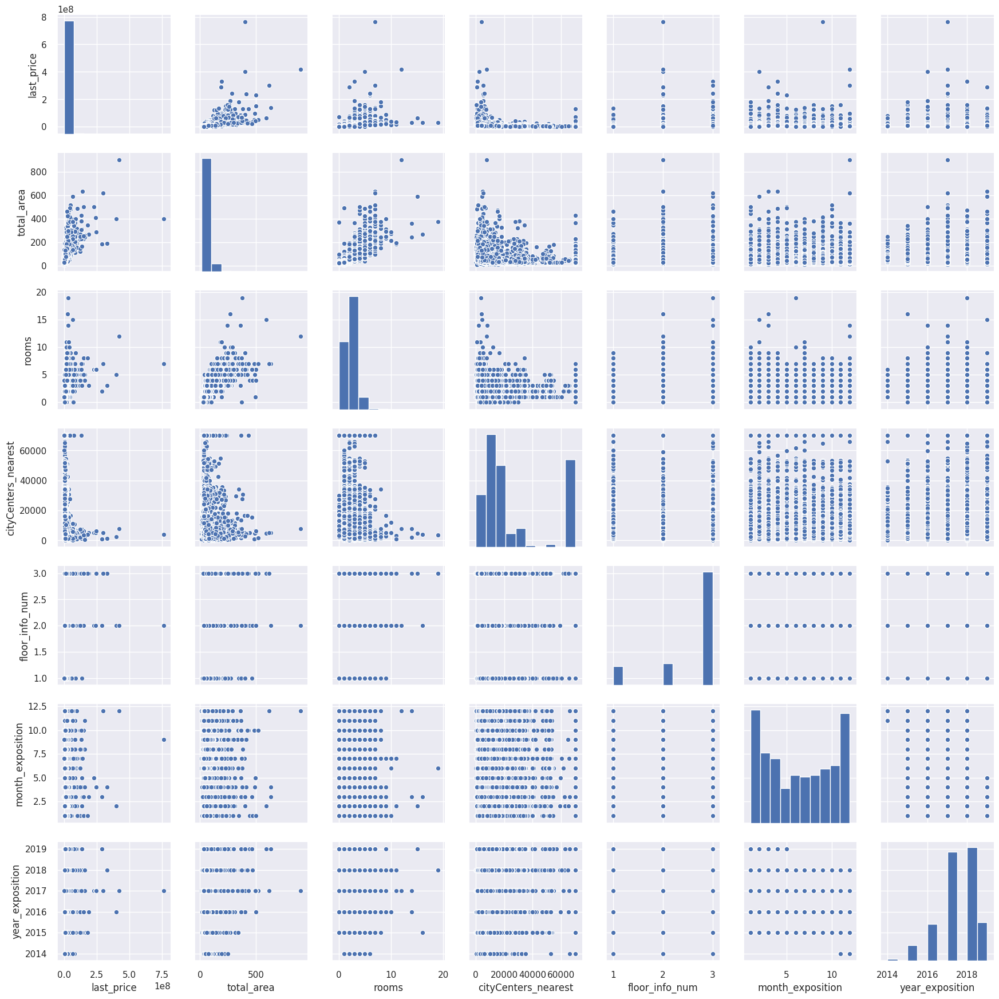

In [69]:
sns.set()
cols = ['last_price', 'total_area', 'rooms', 'cityCenters_nearest', 'floor_info_num',
        'day_of_week_exposition', 'month_exposition', 'year_exposition']
sns.pairplot(estate_data[cols], size = 2.5)
plt.show();

### Вывод
Цена зависит от:   
    площади - чем больше площадь, тем выше цена,   
    удалённости от центра - чем ближе к центру Санкт-Петербурга, тем выше цена.   
    
Ярко выраженной зависимости цены от количества комнат - нет.  

Зависимость цены от того, на каком этаже расположена квартира: меньше всего ценятся с расположением на первом этаже.   

Зависимость от даты размещения:   
    дня недели - с более высокой ценой происходили продажи в первой половине недели,   
    месяца - продажи с более высокими ценами происходили в конце зимы-весной,   
    года - в 2017 году встречались сравнительно высокие цены продаж, в 2014 самый низкий диапазон цен продажи (вероятно влияние падение цен на нефть). 

### Анализ Top-10 населенных пунктов

Выберем 10 населённых пунктов с наибольшим числом объявлений

In [70]:
estate_data['locality_name'].value_counts().head(10).iplot(kind='bar', bins=100)

In [71]:
# Рассчитаем медианное значение price_sqr_meter для сгруппированных данных по колонке locality_name 
price_per_sqr_meter = estate_data[estate_data['locality_name'].isin((estate_data['locality_name'].value_counts().head(10).index))]\
                      .groupby(by='locality_name')['price_per_sqr_meter']\
                      .agg(['median'])\
                      .sort_values(by='median', ascending=False)

price_per_sqr_meter.reset_index(inplace=True)
price_per_sqr_meter

,locality_name,median
0,Санкт Петербург,104688.00000
1,Пушкин,99987.00000
2,Кудрово,95588.00000
3,Парголово,91643.00000
4,Мурино,86250.50000
5,Шушары,76829.00000
6,Колпино,74723.50000
7,Гатчина,67925.00000
8,Всеволожск,65789.00000
9,Выборг,58308.00000


In [72]:
# Визуализируем в виде графика boxplot
col = price_per_sqr_meter["locality_name"]

estate_data.query('locality_name in @col').pivot(columns='locality_name', values='price_per_sqr_meter').iplot(
         kind='box', 
         title='График влияния типа поселения на время продажи', 
         xTitle='Тип поселения', 
         yTitle='Количество дней продажи', layout={'yaxis':{'range':[40000, 130000]} })

### Вывод

Населённый пункт с самой высокой стоимостью жилья - Санкт-Петербург 104 688 руб. за кв. м.  
Населённый пункт с самой низкой стоимостью жилья - Выборг 58 308 руб. за кв. м.

### Определение понятия "центр города"

In [73]:
# Создадим столбец с расстоянием до центра в километрах 
# Округлим до целых значений
estate_data['cityCenters_nearest_km'] = estate_data['cityCenters_nearest']/1000
estate_data['cityCenters_nearest_km'] = round(estate_data['cityCenters_nearest_km'],0)

In [74]:
# Рассчитаем стоимость одного километра
estate_data['price_km'] = round(estate_data['last_price']/estate_data['cityCenters_nearest_km'], 2)

In [75]:
# Рассчитаем среднюю тоимость одного километра для Санкт-Петербурга и построим график
estate_data.query('locality_name == "Санкт Петербург"')\
                      .groupby(by='cityCenters_nearest_km')['price_km']\
                      .agg(['mean'])\
                      .iplot(title='График отношения расстояния от центра города на стоимость', 
                             xTitle='Расстояние до центра города, км.', 
                             yTitle='Стоимость одного километра, руб./км.')

На основании получившегося графика видно резкое изменение поведения величины в диапазоне 3 км. - после этой отметки показатель становится более волотилен, что свидетельствует об изменении катеории жилья относящейся к этой территории.  
Данное предположение коррелирует с понятием "Центрального района" Санкт-Петербурга.

### Вывод

В центр входит область равная радиусу 3 км.

### Анализ отличий факторов для наблюдений из "центра города" и вне центра

"Выделите сегмент квартир в центре. Проанализируйте эту территорию и изучите следующие параметры: площадь, цена, число комнат, высота потолков. Также выделите факторы, которые влияют на стоимость квартиры (число комнат, этаж, удалённость от центра, дата размещения объявления). Сделайте выводы. Отличаются ли они от общих выводов по всему городу?"

In [76]:
# Выделим сегмент квартир в радиусе 10 км от центра СПб
# Выведем описательные статистики
estate_data_in_center = estate_data.query('cityCenters_nearest_km <= 10')
cols = ['total_area', 'last_price', 'rooms', 'ceiling_height']
estate_data_in_center[cols].describe()

,total_area,last_price,rooms,ceiling_height
count,5346.00000,5346.00000,5346.00000,5346.00000
mean,81.66688,12136038.93584,2.57445,2.87907
std,53.33527,20610360.02597,1.36582,0.29778
min,12.00000,1600000.00000,0.00000,2.40000
25%,47.70000,5500000.00000,2.00000,2.70000
50%,69.10000,7950000.00000,2.00000,2.79000
75%,97.00000,12400000.00000,3.00000,3.00000
max,900.00000,763000000.00000,19.00000,3.98000


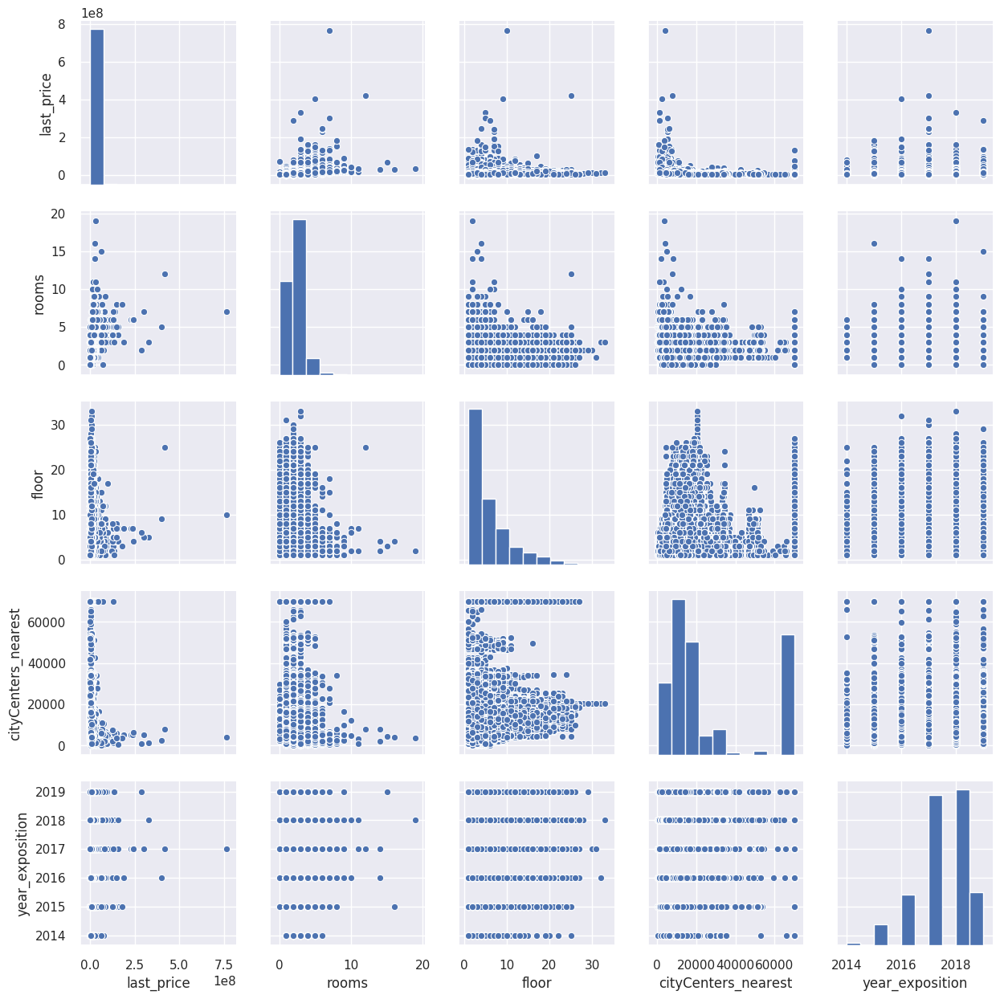

In [77]:
# Построим график типа scatterplot для признаков last_price, rooms, floor, cityCenters_nearest, year_exposition
sns.set() 
cols = ['last_price', 'rooms', 'floor', 'cityCenters_nearest', 'year_exposition']
sns.pairplot(estate_data[cols], size = 2.5)
plt.show();

### Вывод

В центре Санкт-Петербурга можно встретить все разбросы вариантов по площади, цене, количеству комнат и высоте потолков, 
которые были характерны и для более широкого территориального диапазона "СПБ и ближайшая область"

Среди анализируемых показателей, на цену квартар в центре влияют этаж (от 2 до 10 - если первый этаж или выше 10, то цена ниже) и удаленность от центра (чем дальше от центра, тем цена ниже), в 2017 году встречались сравнительно высокие цены продаж, в 2014 самый низкий диапазон цен продажи (вероятно влияние падения цен на нефть), ярко выраженной зависимости цены от количества комнат - нет. 

Такие же характеристики актуальны и в целом для города.

## Вывод

Проанализирован архив объявлений сервиса Яндекс.Недвижимость. В данных выявлено большое количество пропусков и некорректных значений. Это может свидетельствовать как о некорректном пользовательском вводе, так и о проблемах в процессе выгрузки данных. Для анализа ситуации рекомендуется создать bag-report. В случае, если ошибочные значения являются проблемой пользовательского ввода, то имеет смысл подумать над доработкой веб-форм, с которыми работают пользователи (например проверка введенного значения на допустимый диапазон).

Для более детальноо анализа были расчитаны и добавлены в набор данных дополнительне признаки, такие как:
- стоимость квадратного метра
- признаки на основании даты: день недели, месяц и год публикации объявления
- характеристика этажа квартиры
- категория жилья: эконом, комфорт, бизнес, элитное  

Данный подход позволил всесторонне проанализировать рассматриваемый набор данных и выявить основные параметры, которые оказывают существенное влияние на рыночную стоимость объектов недвижимости. 

На формирование рыночной стоимости объектов недвижимости влияют следующие параметры:  
- площадь - чем больше площадь, тем выше цена  
- удалённость от центра/аэропорта - чем ближе к центру Санкт-Петербурга (радиус центра - 3 км) и быстрее добираться до аэропорта, тем выше цена  
- наличие прудов и парков в радиусе 3 км  
- на каком этаже расположена квартира - меньше всего ценятся с расположением на первом этаже    
- день недели и месяц размещения объявления (первая половина недели и конец зимы-весна, соответственно, являются периодами с более высокими ценами)
- экономическая ситуация в стране, способная повлиять на стоимость недвижимости

Выявленые параметры позволят развивать инструменты для разработки автоматизированной системы отслеживания аномалий и мошеннической деятельности, т.к. анализ подсветл диапазоны значений и харакретные особенности поведения того или иного показателя, что позволит либо настроить экспертные правила по этим уставкам, либо натренировать модель ML anomaly detection.